In [ ]:
import os
job_cancel_str="scancel " + os.environ['SLURM_JOBID']
os.system(job_cancel_str)

# Imports, Paths, and loading data

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import sys, os

sys.path.append(os.path.abspath('../..'))

In [3]:
from hit_finding.constants import *
from hit_finding.metrics import *
from learning_tabular.constants import CHANNELS, FAMILIES, LABEL_FIELD
from learning_tabular.preprocessing import load_plate_csv, list_columns
from reproducibility.percantage_replicates_utils import *

In [4]:
# from os import chdir, scandir, makedirs
import matplotlib.pyplot as plt
# from matplotlib.gridspec import GridSpec
import seaborn as sns


from tqdm.notebook import tqdm
from glob import glob

# from itertools import cycle
# from multiprocessing import Pool, cpu_count

import pandas as pd
import numpy as np
import json
import pickle

In [6]:
pd.get_option("display.max_rows",100)
'''/home/alonshp/.conda/envs/tf-env/bin/python'''

output_dir = f'/storage/users/g-and-n/reproduce_results_all'
os.makedirs(output_dir, exist_ok=True)


percantage_replicating_filename = f'percentage_replicating_{num_plates}_{num_rand}.csv'
df_null_p_vals_filename = f'df_null_p_vals_{num_plates}_{num_rand}.csv'
percantage_replicating_path = os.path.join(output_dir, percantage_replicating_filename)
df_null_p_vals_path = os.path.join(output_dir, df_null_p_vals_filename)

null_dist_filename = f'null_distribution_replicates_{num_plates}_{num_rand}.pickle'
null_dist_path = os.path.join(output_dir, null_dist_filename)
null_dist_scores_path = os.path.join(output_dir, 'null_scores')


cols = json.load(open('/storage/users/g-and-n/plates/columns-fs.json', 'r'))
# cols = json.load(open('/storage/users/g-and-n/plates/columns.json', 'r'))

chans = [c for c in cols.keys() if c not in ['GENERAL', 'MIXED']]
chans

del cols['GENERAL']
# del cols['MIXED'] 

cols['ALL'] = sum(cols.values(), [])
num_channels_all = len(cols['ALL'] )


err_fld = f'/storage/users/g-and-n/tabular_models_results/41/ALL/zscores/'
files = [(int(f.name.split('.')[0]), f.name) for f in os.scandir(err_fld) if f.name.endswith('.csv')]

if 'alonshp' in os.path.abspath('../code'):
    userid = 'alonshp'
else:
    userid = 'naorko'

if userid == 'alonshp':
    res_dir = os.path.abspath('../../../assafzar-group/g-and-n/')
    sys.path.append(res_dir)
    res_pth = os.path.join('/sise/assafzar-group/g-and-n/tabular_models_results/30000/results/z_scores/pure')
    plates = os.listdir(os.path.join(res_pth, 'err'))
else:
    sys.path.append(os.path.abspath('../code'))
    res_pth = '../../../tabular_models_results/11/results/z_scores/frac_score'
    t = 4
    # plates = os.listdir(os.path.join(res_pth, str(4)))
    res_path_thresh = os.path.join(res_pth, str(t))
    plates = os.listdir(os.path.join(res_pth, str(t)))

    

FileNotFoundError: [Errno 2] No such file or directory: '../../../tabular_models_results/11/results/z_scores/frac_score/4'

### Pre proccess models zscores

In [8]:

zscores = {
    # '4to1':{'path':f'/storage/users/g-and-n/tabular_models_results/41/ALL/zscores'},
    # '2to1':{'path':f'/storage/users/g-and-n/tabular_models_results/21/ALL/zscores'},
    '1to1':{'path':f'/storage/users/g-and-n/tabular_models_results/111/ALL/zscores'},
    'raw':{'path': f'/storage/users/g-and-n/tabular_models_results/30000/results/z_scores/pure/raw'},
    # '5to5':{'path':f'/storage/users/g-and-n/tabular_models_results/55/ALL/zscores'},
}



# get plate numbers
cur_fld = f'/storage/users/g-and-n/tabular_models_results/41/ALL/'
all_plates = glob(os.path.join(cur_fld, 'zscores', '*'))
# plate_nums = [
#     25579, 25580, 25581, 25583,
#     25891, 25892, 25903, 25911,
#     24646, 24647, 24648, 24651,
#     26724, 26730, 26744, 26745,
#     25993, 25994, 25997, 26002,
#     24638, 24639, 24640, 24641,
#     25904, 25912, 25913, 25914,
#     26767, 26768, 26771, 26772,
#     24514, 24515, 24516, 24517,
#     24656, 24657, 24661, 24663,
#     26681, 26682, 26683, 26684,
#     26666, 26668, 26669, 26786,
#     26702, 26703, 26739, 26748,
#     25689, 25690, 25692, 25724,
#     24652, 24653, 24654, 24655,
#     24756, 24758, 24759, 24773,
#     26640, 26641, 26642, 26643,
#     24684, 24685, 24687, 24688,
#     26685, 26688, 26695, 26705,
#     25925, 25929, 25931, 25935
# ]
# plate_nums = [f'{p}.csv' for p in plate_nums]
plate_nums = [os.path.split(plate)[-1] for plate in all_plates]


# load zscores
for model in zscores.keys():
    plates =  [os.path.join(zscores[model]['path'], plate) for plate in plate_nums]
    zscores[model]['all'] = pd.concat([pd.read_csv(pth, index_col=[0, 1, 2, 3]) for pth in plates])
    

In [37]:
### Drop columns that are not in other results

# find joint columns
joint_cols = []
for model in zscores.keys():
    model_cols = zscores[model]['all'].columns
    if len(joint_cols)==0:
        joint_cols = model_cols
        print(len(joint_cols))
    else:
        joint_cols = np.intersect1d(joint_cols,model_cols)
        print(len(joint_cols))
        
# drop non-joint columns
for model in zscores.keys():
    zscores[model]['all'].drop(columns=[c for c in zscores[model]['all'].columns if c not in joint_cols], inplace=True)
    print(zscores[model]['all'].shape)

169
169
(146599, 169)
(153015, 169)


In [16]:
n, feature_n = zscores['1to1']['all'].shape
feature_n

In [41]:
# divide control cells and treated cells
for model in zscores.keys():

    zscores[model]['trt'] =zscores[model]['all'].query('Metadata_ASSAY_WELL_ROLE == "treated"')
    zscores[model]['ctl'] =zscores[model]['all'].query('Metadata_ASSAY_WELL_ROLE == "mock"')

In [19]:
for model in zscores.keys():
    print(zscores[model]['trt'].index.get_level_values(2).value_counts().value_counts())

4    24933
3     2759
8     1913
2      401
7      322
1      106
6        4
Name: Metadata_broad_sample, dtype: int64
4    24933
3     2759
8     1913
2      401
7      322
1      106
6        4
Name: Metadata_broad_sample, dtype: int64


## Plates statistics

In [95]:
trt_idx = zscores['raw']['trt'].reset_index()[['Plate', 'Metadata_ASSAY_WELL_ROLE', 'Metadata_broad_sample', 'Image_Metadata_Well']]
plates_rep = trt_idx.groupby(['Metadata_broad_sample']).apply(lambda x: x.Plate.to_list())
plates_rep = plates_rep.apply(sorted)
plates_stat = pd.concat([plates_rep, plates_rep.apply(len)], axis=1).rename({0: 'Plates name', 1:'Number of replicates'}, axis=1)
plates_stat.head()

,Plates name,Number of replicates
Metadata_broad_sample,,
BRD-A00037023-001-05-1,"[25579, 25580, 25581, 25583]",4
BRD-A00051892-001-05-0,"[25689, 25690, 25692, 25724]",4
BRD-A00100033-001-04-8,"[24294, 24295, 24297, 24300, 25937, 25938, 259...",8
BRD-A00214921-001-04-2,"[25565, 25566, 25567, 25568]",4
BRD-A00250346-001-05-0,"[25434, 25435, 25436, 25485]",4


In [92]:
plates_stat['Number of replicates'].value_counts().sort_index()

1      106
2      401
3     2759
4    24933
6        4
7      322
8     1913
Name: Number of replicates, dtype: int64

In [94]:
plates_stat['Plates name'].apply(str).value_counts()

[25579, 25580, 25581, 25583]                         320
[26006, 26007, 26008, 26009]                         320
[26640, 26641, 26642, 26643]                         320
[24646, 24647, 24648, 24651]                         320
[25689, 25690, 25692, 25724]                         320
                                                    ... 
[24319, 24321, 24357, 25989, 25990, 25991, 25992]      1
[24305, 24306, 24307, 24352, 25955, 25965, 25966]      1
[25372, 25374, 25376]                                  1
[25683, 25686, 25688]                                  1
[24278, 24279, 24293, 26224, 26232, 26247]             1
Name: Plates name, Length: 131, dtype: int64

In [89]:
plates_stat.to_csv('/storage/users/g-and-n/plates/stats.csv')

# Produce null disribution

## Compute median scores

In [20]:
cpds_med_score = {f'{m}_{t}': get_replicates_score(zscores[m][t])
                  for m in zscores.keys()
                  for t in ['trt', 'ctl']
                 }

cpds_score_df_trt = pd.DataFrame({k[:-4]: v for k, v in cpds_med_score.items() if 'trt' in k})
cpds_score_df_ctl = pd.DataFrame({k[:-4]: v for k, v in cpds_med_score.items() if 'ctl' in k})

display(cpds_score_df_trt)

,1to1,raw
BRD-A00037023-001-05-1,0.275282,0.569141
BRD-A01039955-001-05-8,0.207973,0.613207
BRD-A01535438-001-07-8,0.202449,0.589143
BRD-A02131228-001-05-3,0.403371,0.709368
BRD-A03635368-001-06-0,0.145445,0.576436
...,...,...
BRD-K98161738-001-01-5,-0.071276,0.009186
BRD-K98637033-001-01-6,0.160528,0.018349
BRD-K98704738-001-01-2,0.033076,0.081047
BRD-K98944347-001-01-7,-0.059288,-0.123199


## Create null distribution

In [8]:
null_dist_path

'/storage/users/g-and-n/reproduce_results_all/null_distribution_replicates_20_500.pickle'

In [9]:
if not os.path.exists(null_dist_path):

    replicates_df, cpds = get_duplicate_replicates(zscores['1to1']['trt'],min_num_reps=4)
    null_distribution_replicates = get_null_distribution_replicates(replicates_df, cpds, rand_num=num_rand,num_reps_in_rand=4)

    duplicate_replicates = assert_null_distribution(null_distribution_replicates)
    assert len(duplicate_replicates)==0, 'there are duplicate replicates in null distribution' ## no replicates


    # null_distribution_replicates.to_csv(f'null_distribution_replicates_{num_plates}.csv')
    with open(null_dist_path, 'wb') as handle:
        pickle.dump(null_distribution_replicates, handle, protocol=pickle.HIGHEST_PROTOCOL)

else:
    with open(null_dist_path, 'rb') as f:
    # Load the pickle file
        null_distribution_replicates = pickle.load(f)
    # null_distribution_replicates = pickle.load(null_dist_filename)
    
# replicates_df.head()
len(null_distribution_replicates)

24933

In [12]:
null_distribution_replicates['BRD-A00037023-001-05-1'][0]

[(25490, 'treated', 'BRD-K33728616-001-05-7', 'l17'),
 (26126, 'treated', 'BRD-K48276916-001-05-7', 'g09'),
 (25593, 'treated', 'BRD-K02065805-001-05-2', 'f05'),
 (25892, 'treated', 'BRD-K73400194-001-01-3', 'n01')]

In [21]:
cpds = list(null_distribution_replicates.keys())
cpds.sort()
len(cpds)

24933

### Load null distribution scores

In [25]:
glob(os.path.join(null_dist_scores_path, 'raw', '*')).__len__()

998

In [38]:
cpds_score_df_trt = pd.DataFrame(columns=zscores.keys())
null_distribution_medians = {}
for method in zscores.keys():
    null_distribution_medians[method] = {}
    scores_files = glob(os.path.join(null_dist_scores_path, method, '*'))
    scores_files.sort()
    for scores_file in tqdm(scores_files):
        with open(scores_file, 'rb') as f:
        # Load the pickle file
            d = pickle.load(f)
        for k, (med_score, null_med_scores) in d.items():
            null_distribution_medians[method][k] = null_med_scores
            cpds_score_df_trt.loc[k, method] = med_score

100%|██████████| 998/998 [00:05<00:00, 178.64it/s]


## Calculate Median Scores P-values

In [39]:
if not os.path.exists(percantage_replicating_path):
    # null_distribution_medians = {}
    # for model in zscores.keys():
    #     null_distribution_medians[model] = get_null_dist_median_scores(null_distribution_replicates, zscores[model]['trt'])
    # null_distribution_medians['raw1to1'] = get_null_dist_median_scores(null_distribution_replicates, cpd_raw1to1_trt)

    df_null_p_vals = pd.DataFrame([])
    methods=zscores.keys()
    for method in zscores.keys():
        # null_distribution_medians = get_null_dist_median_scores(null_distribution_replicates, cpds_score_df_trt,method=method)
        null_p_vals = get_moa_p_vals(null_distribution_medians[method], cpds_score_df_trt, method=method)
        method_df_null_p_vals = pd.DataFrame.from_dict(null_p_vals,orient='index',columns=[method])
        if len(df_null_p_vals)>0:
            df_null_p_vals = df_null_p_vals.join(method_df_null_p_vals)
        else:
            df_null_p_vals = method_df_null_p_vals.copy()

        # cpds_score_df_trt = cpds_score_df_trt.join(df_null_p_vals)

    display(df_null_p_vals)

    medians = cpds_score_df_trt[methods].melt(var_name=["method"],value_name='median_score',ignore_index=False).reset_index()
    p_vals = df_null_p_vals[methods].melt(var_name=["method"],value_name='p_val',ignore_index=False).reset_index()
    cpds_score_df_trt.to_csv(f'cpds_score_df_trt_{num_plates}.csv')
    df_null_p_vals.to_csv(df_null_p_vals_path)
    # a = pd.merge(medians,p_vals, left_on=['index','median_score'], right_on=['index','p_val'])
    percantage_replicating_df = pd.merge(medians,p_vals, on=['index','method'])
    percantage_replicating_df.to_csv(percantage_replicating_path) #, index=False, sep="\t")
    
else:
    
    percantage_replicating_df = pd.read_csv(percantage_replicating_path)
    df_null_p_vals = pd.read_csv(df_null_p_vals_path)


,1to1,raw
BRD-A00037023-001-05-1,0.004,0.004
BRD-A00051892-001-05-0,0.014,0.004
BRD-A00214921-001-04-2,0.066,0.326
BRD-A00250346-001-05-0,0.048,0.004
BRD-A00430899-001-05-9,0.004,0.014
...,...,...
BRD-M97057852-001-01-4,0.298,0.052
BRD-M97109212-001-01-8,0.002,0.096
BRD-M97925630-001-01-1,0.032,0.014
BRD-M98484762-001-01-8,0.046,0.132


In [40]:
percantage_replicating_df

,index,method,median_score,p_val
0,BRD-A00037023-001-05-1,1to1,0.275282,0.004
1,BRD-A00051892-001-05-0,1to1,0.20293,0.014
2,BRD-A00214921-001-04-2,1to1,0.139107,0.066
3,BRD-A00250346-001-05-0,1to1,0.14644,0.048
4,BRD-A00430899-001-05-9,1to1,0.277543,0.004
...,...,...,...,...
49861,BRD-M97057852-001-01-4,raw,0.306816,0.052
49862,BRD-M97109212-001-01-8,raw,0.247369,0.096
49863,BRD-M97925630-001-01-1,raw,0.364925,0.014
49864,BRD-M98484762-001-01-8,raw,0.211608,0.132


In [50]:
df_null_p_vals

,1to1,raw
BRD-A00037023-001-05-1,0.004,0.004
BRD-A00051892-001-05-0,0.014,0.004
BRD-A00214921-001-04-2,0.066,0.326
BRD-A00250346-001-05-0,0.048,0.004
BRD-A00430899-001-05-9,0.004,0.014
...,...,...
BRD-M97057852-001-01-4,0.298,0.052
BRD-M97109212-001-01-8,0.002,0.096
BRD-M97925630-001-01-1,0.032,0.014
BRD-M98484762-001-01-8,0.046,0.132


# Load results (PR and SS)
based on https://github.com/broadinstitute/lincs-profiling-complementarity/blob/master/1.Data-exploration/Profiles_level4/cell_painting/9.cellpainting-percent-replicating-subsampled-and-nonspherized.ipynb



In [8]:
import re
import os
import pathlib
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import pickle
sns.set_style("darkgrid")
sns.set_context("talk")

In [9]:
# load reproducibility results
percantage_replicating_df = pd.read_csv(percantage_replicating_path)
percantage_replicating_df.method.value_counts()

# load p_vals
df_null_p_vals= pd.read_csv(df_null_p_vals_path)
df_null_p_vals.rename( columns={'Unnamed: 0':'Metadata_broad_sample'}, inplace=True )
df_null_p_vals.head()

,Metadata_broad_sample,1to1,raw
0,BRD-A00037023-001-05-1,0.004,0.004
1,BRD-A00051892-001-05-0,0.014,0.004
2,BRD-A00214921-001-04-2,0.066,0.326
3,BRD-A00250346-001-05-0,0.048,0.004
4,BRD-A00430899-001-05-9,0.004,0.014


In [22]:
percantage_replicating_df.head()

,Unnamed: 0,index,method,median_score,p_val
0,0,BRD-A00037023-001-05-1,1to1,0.275282,0.004
1,1,BRD-A00051892-001-05-0,1to1,0.202930,0.014
2,2,BRD-A00214921-001-04-2,1to1,0.139107,0.066
3,3,BRD-A00250346-001-05-0,1to1,0.146440,0.048
4,4,BRD-A00430899-001-05-9,1to1,0.277543,0.004


In [10]:
to_win = False

mcn_sep =  '/'
def convert_path_to_machine(path):
    spl = path.split(mcn_sep)
    if to_win:
        return os.path.join('R:\\', *spl[spl.index('g-and-n'):])
    else:
        return os.path.join('/sise/assafzar-group/', *spl[spl.index('g-and-n'):])


In [11]:
ss_scores = {}

# mtd_names = {
#     41: '4to1',
#     21: '2to1',
#     11: '1to1',
#     1: 'baseline',
#     111: '1to1-fs',
#     0: 'baseline-fs',
#     55: '5to5',
#     5: 'baseline-all-fs',
# }

mtd_names = {
    41: '4to1',
    21: '2to1',
    11: '1to1',
    1: 'baseline',
    111: '1to1',
    0: 'raw',
    55: '5to5',
    5: 'baseline-all-fs',
}

ss_scores = {}
methods = []
for exp_id in [111]:#[41, 21, 11]:
    method = mtd_names[exp_id]
    methods.append(method)
    exp_fld = f'/sise/assafzar-group/g-and-n/tabular_models_results/{exp_id}'
    channels_pths = convert_path_to_machine(os.path.join(exp_fld, 'channel '))
    channels = ['AGP', 'DNA', 'ER', 'Mito', 'RNA']
    channels_pths = [os.path.join(exp_fld, 'ALL')] + [channels_pths + c for c in channels]
    channels = ['ALL'] + channels
    res_pths = [os.path.join(chan_pth, 'ss-scores.csv') for chan_pth in channels_pths]
    ss_scores[method] = pd.concat([pd.read_csv(pth, index_col=[0]).add_prefix(f'{c}_') for c, pth in zip(channels, res_pths)], axis=1)
    
for exp_id in [0]:#[41, 21, 11]:
    method = mtd_names[exp_id]
    methods.append(method)
    exp_fld = f'/sise/assafzar-group/g-and-n/tabular_models_results/{exp_id}'
    exp_fld = convert_path_to_machine(exp_fld)
    channels = ['ALL', 'AGP', 'DNA', 'ER', 'Mito', 'RNA']
    res_pths = [os.path.join(exp_fld, f'{chan}-ss-scores.csv') for chan in channels]
    ss_scores[method] = pd.concat([pd.read_csv(pth, index_col=[0]).add_prefix(f'{c}_') for c, pth in zip(channels, res_pths)], axis=1)


In [12]:
for method in methods:
    # ss_scores[model]['ss']= ss_scores[model]['ss'].add_prefix('ALL_')
    ss_scores[method]= ss_scores[method].add_suffix(f'_{method}')
# ss_scores['2to1']['ss'] = ss_scores['2to1']['ss'].add_prefix('ALL_')
# ss_scores['1to1']['ss'] = ss_scores['1to1']['ss'].add_prefix('ALL_')

# merge map and raw
if len(ss_scores)==2:
    all_ss = pd.merge(ss_scores['1to1'], ss_scores['raw'],left_index=True, right_index=True, suffixes=('1to1', 'raw'))
else:
    pass
# all_ss = pd.merge(ss_scores['4to1']['ss'], ss_scores['2to1']['ss'],left_index=True, right_index=True, suffixes=('_4to1','_2to1'))
# all_ss.columns
all_ss.columns

# keep only 'All' results
all_ss = all_ss.filter(regex='ALL_')
all_ss.columns

Index(['ALL_Med_Corr_1to1', 'ALL_SS_2_1to1', 'ALL_MAS_2_1to1', 'ALL_SS_3_1to1',
       'ALL_MAS_3_1to1', 'ALL_SS_4_1to1', 'ALL_MAS_4_1to1', 'ALL_SS_5_1to1',
       'ALL_MAS_5_1to1', 'ALL_SS_6_1to1', 'ALL_MAS_6_1to1', 'ALL_SS_7_1to1',
       'ALL_MAS_7_1to1', 'ALL_SS_8_1to1', 'ALL_MAS_8_1to1', 'ALL_SS_9_1to1',
       'ALL_MAS_9_1to1', 'ALL_SS_10_1to1', 'ALL_MAS_10_1to1', 'ALL_SS_11_1to1',
       'ALL_MAS_11_1to1', 'ALL_SS_12_1to1', 'ALL_MAS_12_1to1',
       'ALL_SS_13_1to1', 'ALL_MAS_13_1to1', 'ALL_SS_14_1to1',
       'ALL_MAS_14_1to1', 'ALL_SS_15_1to1', 'ALL_MAS_15_1to1',
       'ALL_SS_16_1to1', 'ALL_MAS_16_1to1', 'ALL_SS_17_1to1',
       'ALL_MAS_17_1to1', 'ALL_SS_18_1to1', 'ALL_MAS_18_1to1',
       'ALL_SS_19_1to1', 'ALL_MAS_19_1to1', 'ALL_SS_20_1to1',
       'ALL_MAS_20_1to1', 'ALL_Med_Corr_raw', 'ALL_SS_2_raw', 'ALL_MAS_2_raw',
       'ALL_SS_3_raw', 'ALL_MAS_3_raw', 'ALL_SS_4_raw', 'ALL_MAS_4_raw',
       'ALL_SS_5_raw', 'ALL_MAS_5_raw', 'ALL_SS_6_raw', 'ALL_MAS_6_raw',
       'A

In [14]:
# all_ss.columns
ts = [2,4,6,8,10,12,14,16,18,20]
ss_cols = []
for t in ts:
    t_cols = all_ss.filter(like=f'SS_{t}_').columns
    ss_cols+=list(t_cols)
    
all_ss_t = all_ss[ss_cols]
all_ss_t.head()
all_ss_t.columns

# keep only 'All' results
only_all_ss_t = all_ss_t.filter(regex='ALL_')
all_ss_t.columns

Index(['ALL_SS_2_1to1', 'ALL_SS_2_raw', 'ALL_SS_4_1to1', 'ALL_SS_4_raw',
       'ALL_SS_6_1to1', 'ALL_SS_6_raw', 'ALL_SS_8_1to1', 'ALL_SS_8_raw',
       'ALL_SS_10_1to1', 'ALL_SS_10_raw', 'ALL_SS_12_1to1', 'ALL_SS_12_raw',
       'ALL_SS_14_1to1', 'ALL_SS_14_raw', 'ALL_SS_16_1to1', 'ALL_SS_16_raw',
       'ALL_SS_18_1to1', 'ALL_SS_18_raw', 'ALL_SS_20_1to1', 'ALL_SS_20_raw'],
      dtype='object')

In [15]:
low_thres = 0.002

# add fields of log p_vals 
for m in methods:
    df_null_p_vals[m] = np.where(df_null_p_vals[m]<low_thres,low_thres,df_null_p_vals[m])
    df_null_p_vals[f'{m}_log'] = - np.log10(df_null_p_vals[m])
# df_null_p_vals['raw_log'] = - np.log10(df_null_p_vals['raw'])
# df_null_p_vals['raw1to1_log'] = - np.log10(df_null_p_vals['raw1to1'])
df_null_p_vals.isna().sum()
# df_null_p_vals['map_log-raw_log'] = df_null_p_vals['map_log']-df_null_p_vals['raw_log']
# df_null_p_vals['map_log-raw1to1_log'] = df_null_p_vals['map_log']-df_null_p_vals['raw1to1_log']

Metadata_broad_sample    0
1to1                     0
raw                      0
1to1_log                 0
raw_log                  0
dtype: int64

In [16]:
df_null_p_vals.columns


Index(['Metadata_broad_sample', '1to1', 'raw', '1to1_log', 'raw_log'], dtype='object')

In [17]:
percantage_replicating_df_non_melt = pd.merge(all_ss_t,df_null_p_vals, on=['Metadata_broad_sample'],suffixes=('_SS','_p_val'))
percantage_replicating_df_non_melt.head()
percantage_replicating_df_non_melt.isna().sum()

Metadata_broad_sample    0
ALL_SS_2_1to1            0
ALL_SS_2_raw             0
ALL_SS_4_1to1            0
ALL_SS_4_raw             0
ALL_SS_6_1to1            0
ALL_SS_6_raw             0
ALL_SS_8_1to1            0
ALL_SS_8_raw             0
ALL_SS_10_1to1           0
ALL_SS_10_raw            0
ALL_SS_12_1to1           0
ALL_SS_12_raw            0
ALL_SS_14_1to1           0
ALL_SS_14_raw            0
ALL_SS_16_1to1           0
ALL_SS_16_raw            0
ALL_SS_18_1to1           0
ALL_SS_18_raw            0
ALL_SS_20_1to1           0
ALL_SS_20_raw            0
1to1                     0
raw                      0
1to1_log                 0
raw_log                  0
dtype: int64

In [57]:
percantage_replicating_df_non_melt.head()   

,Metadata_broad_sample,ALL_SS_2_1to1,ALL_SS_2_raw,ALL_SS_4_1to1,ALL_SS_4_raw,ALL_SS_6_1to1,ALL_SS_6_raw,ALL_SS_8_1to1,ALL_SS_8_raw,ALL_SS_10_1to1,...,ALL_SS_16_1to1,ALL_SS_16_raw,ALL_SS_18_1to1,ALL_SS_18_raw,ALL_SS_20_1to1,ALL_SS_20_raw,1to1,raw,1to1_log,raw_log
0,BRD-A00037023-001-05-1,0.115385,0.409763,0.023669,0.081361,0.001479,0.001479,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.004,0.004,2.397940,2.397940
1,BRD-A00051892-001-05-0,0.065089,0.227811,0.007396,0.002959,0.000000,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.014,0.004,1.853872,2.397940
2,BRD-A00214921-001-04-2,0.050296,0.338757,0.004438,0.035503,0.000000,0.001479,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.066,0.326,1.180456,0.486782
3,BRD-A00250346-001-05-0,0.170118,0.360947,0.042899,0.054734,0.010355,0.004438,0.001479,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.048,0.004,1.318759,2.397940
4,BRD-A00430899-001-05-9,0.113905,0.346154,0.023669,0.069527,0.000000,0.001479,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.004,0.014,2.397940,1.853872


# Plot results
based on https://github.com/broadinstitute/lincs-profiling-complementarity/blob/master/1.Data-exploration/Profiles_level4/cell_painting/9.cellpainting-percent-replicating-subsampled-and-nonspherized.ipynb



0.4435487105442586
0.4717843821441463


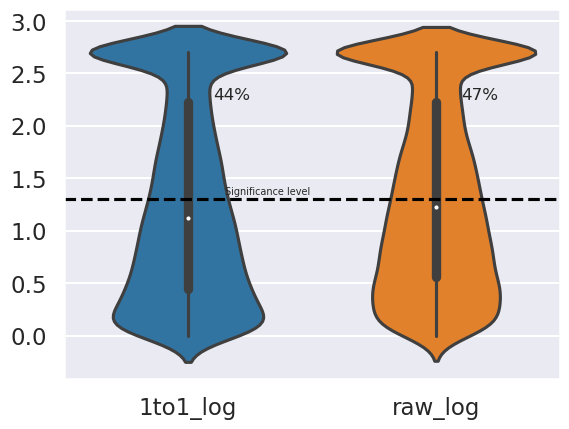

In [27]:
percantage_replicating_df_non_melt.head()

log_methods = [m +'_log' for m in methods]
# percantage_replicating_df_non_melt[log_methods].head()
fig = sns.violinplot(data=percantage_replicating_df_non_melt[log_methods])
log_val = -np.round(np.log10(0.05),5)
fig.axhline(log_val, ls='--', c='black')
# fig.legend(loc = 'lower right')
fig.text(0.15,0.05+log_val, "Significance level",fontsize=7)
for i, m in enumerate(log_methods):
        repre = percantage_replicating_df_non_melt[percantage_replicating_df_non_melt[m]>log_val][m].count()/len(percantage_replicating_df_non_melt)
        print(repre)
        fig.text(0.1+i, 2.25,str(int(np.round(repre,2)*100))+'%', fontsize=12) #add text
# [m +'_log' for m in methods]


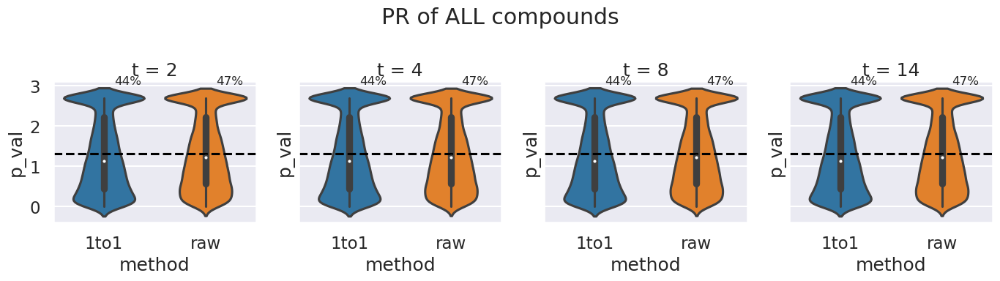

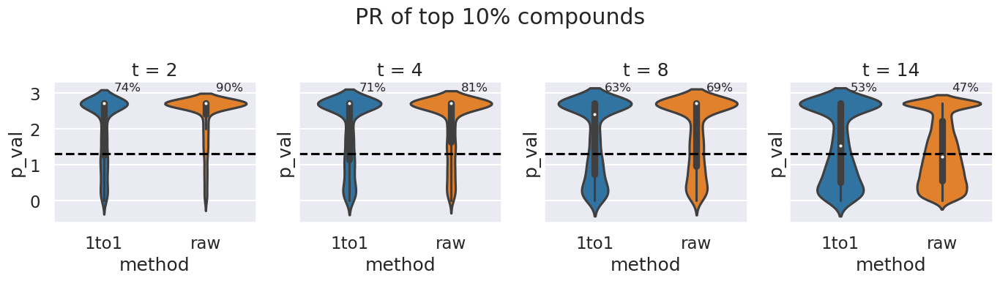

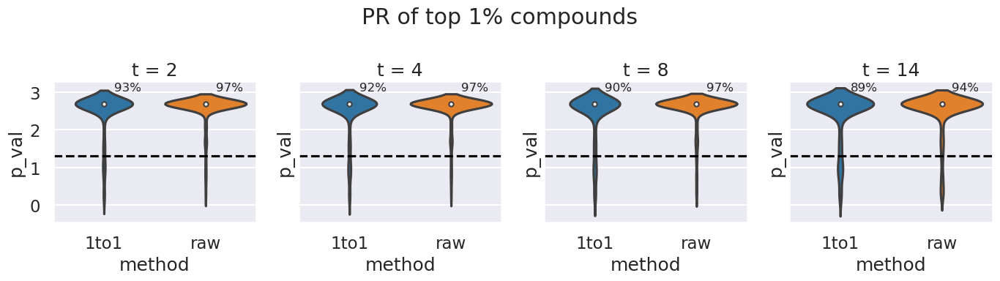

In [90]:
log_val = -np.round(np.log10(0.05), 5)
ts = [2,4,8,14]

# fig.subplots_adjust(hspace=0.4, wspace=0.4)
for quantile_threshold in [0, 0.9, 0.99]:
    fig, ax = plt.subplots(nrows=1, ncols=len(ts), figsize=(14,4), facecolor='#FFFFFF',sharey=True)

    if quantile_threshold >0:
        fig.suptitle(f'PR of top {(1-quantile_threshold):.0%} compounds') 
    else:
        fig.suptitle('PR of ALL compounds')
    for i, t in enumerate(ts):
        violin = {}
        ind2={}
        ax[i].set_title(f't = {t}', fontsize = 18,y=1)
        for m in methods:

            quantile = percantage_replicating_df_non_melt[f'ALL_SS_{t}_{m}'].quantile(quantile_threshold)
            # print(f'Method {m} Threshold {t} q:{quantile:.2f}')
            violin[m] = percantage_replicating_df_non_melt[percantage_replicating_df_non_melt[f'ALL_SS_{t}_{m}']>=quantile][f'{m}_log'].values

        violin_df = pd.concat([pd.DataFrame({'p_val': p_vals, 'method': [m]*len(p_vals)}) for m, p_vals in violin.items()])
        _ = sns.violinplot(data=violin_df, ax=ax[i], y='p_val', x='method')
        percent_rep = violin_df.groupby('method').apply(lambda d: (d["p_val"] >= log_val).sum() / d.shape[0])
        
        ax[i].axhline(log_val, ls='--', c='black')
        # fig.legend(loc = 'lower right')
        # ax[i].text(0.06,0.05+log_val, "Significance level", fontsize=11)
        for j, m in enumerate(methods):
            repre = percent_rep[m]
            # print(f'\tMethod {m} Threshold {t} q:{repre:.2f}')
            ax[i].text(0.1+j, 3.05,f'{repre:.0%}', fontsize=12) #add text
    
    fig.tight_layout()
    fig.savefig(f'/sise/assafzar-group/g-and-n/tabular_models_results/plots/reproducibility/PR of top {(1-quantile_threshold):.0%} compounds.eps', format='eps')
    fig.savefig(f'/sise/assafzar-group/g-and-n/tabular_models_results/plots/reproducibility/PR of top {(1-quantile_threshold):.0%} compounds.png', format='png')
    plt.show()


In [33]:
percantage_replicating_df[f'log10_p_val'] = - np.log10(percantage_replicating_df['p_val'])

/home/naorko/.conda/envs/tf-env/lib/python3.8/site-packages/pandas/core/arraylike.py:364: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [34]:
x=2
pr_methods = {}
pr_ss = pd.DataFrame([])
for m in methods:
    cols = ['Metadata_broad_sample',m,f'{m}_log'] + [col for col in percantage_replicating_df_non_melt.columns if f'ALL_SS_{x}_{m}' in col]
    # sens_t = sens_t[percantage_replicating_df_non_melt.filter(regex=f'ALL_SS_{x}_')
    pr_methods[m] = percantage_replicating_df_non_melt.loc[:,cols]
    pr_methods[m]['method'] = m
    pr_methods[m].rename(columns={'Metadata_broad_sample':'index',f'ALL_SS_{x}_{m}':'SS', m:'pval',f'{m}_log':'pval_log'},inplace=True)
    pr_ss = pd.concat([pr_ss, pr_methods[m]])
# pr_ss = pd.DataFrame(pr_methods)
pr_ss.head()
# len(pr_ss), len(percantage_replicating_df_non_melt)

,index,pval,pval_log,SS,method
0,BRD-A00037023-001-05-1,0.004,2.397940,0.115385,1to1
1,BRD-A00051892-001-05-0,0.014,1.853872,0.065089,1to1
2,BRD-A00214921-001-04-2,0.066,1.180456,0.050296,1to1
3,BRD-A00250346-001-05-0,0.048,1.318759,0.170118,1to1
4,BRD-A00430899-001-05-9,0.004,2.397940,0.113905,1to1


## Create melted representation of all metrics

In [36]:
ind_cols = ['index','method']
cols = ['index','method','SS', 'median_score', 'pval', 'pval_log']
melt_all = pd.merge(pr_ss, percantage_replicating_df, on=ind_cols)[cols]
melt_all.head()

,index,method,SS,median_score,pval,pval_log
0,BRD-A00037023-001-05-1,1to1,0.115385,0.275282,0.004,2.397940
1,BRD-A00051892-001-05-0,1to1,0.065089,0.202930,0.014,1.853872
2,BRD-A00214921-001-04-2,1to1,0.050296,0.139107,0.066,1.180456
3,BRD-A00250346-001-05-0,1to1,0.170118,0.146440,0.048,1.318759
4,BRD-A00430899-001-05-9,1to1,0.113905,0.277543,0.004,2.397940


In [ ]:
quantile_threshold = 0.99
melt_percentile = pd.DataFrame()
min_num_samples = len(percantage_replicating_df_non_melt)

for m in methods:

    quantile = melt_all[melt_all['method']==m]['SS'].quantile(quantile_threshold)
    print(f'Method {m} Threshold {t} q:{quantile:.2f}')
    percentile_method_df = melt_all[(melt_all['method']==m) & (melt_all['SS'] > quantile)]
    melt_percentile = pd.concat([melt_percentile, percentile_method_df])
    # violin[m] = percantage_replicating_df_non_melt[percantage_replicating_df_non_melt[f'ALL_SS_{t}_{m}']>=quantile][f'{m}_log'].values
    # ind2[m] = percantage_replicating_df_non_melt[percantage_replicating_df_non_melt[f'ALL_SS_{t}_{m}']>=quantile][f'{m}_log'].index
    # num_samples_filtered = len(violin[m])
    # min_num_samples = min(min_num_samples, num_samples_filtered)
    # print(min_num_samples)

In [38]:
def rename_cols(df):
    'Rename columns from dose number to actual doses'
    
    df.sortname(columns= {'dose_1' : '0.04 uM', 'dose_2':'0.12 uM', 'dose_3':'0.37 uM',
                        'dose_4': '1.11 uM', 'dose_5':'3.33 uM', 'dose_6':'10 uM'}, inplace = True)
    return df

def melt_df(df, col_name):
    """
    This function returns a reformatted dataframe with 
    3 columns: cpd, dose number and dose_values(median score or p-value)
    """
    # df = df.melt(id_vars=['cpd', 'no_of_replicates'], var_name="dose", value_name=col_name)
    df = df.melt(id_vars=['cpd'], var_name="p_val", value_name=col_name)
    return df

def merge_p_median_vals(df_cpd_vals, df_null):
    """
    This function merge p_values and median scores 
    dataframes for each compound for all doses(1-6) 
    """
    df_p_vals = melt_df(df_null, 'p_values')
    df_cpd_vals = melt_df(df_cpd_vals, 'median_scores')
    df_cpd_vals['p_values'] = df_p_vals['p_values']
    return df_cpd_vals


In [39]:
def plot_p_vs_median(df, path, file_name,x_col="fraction_score", y_col="log10_p_val", percentile = 0,alpha=0.1):
    
    """plot p_values vs median correlation scores for each compound for all doses (1-6)"""
    
    if not os.path.exists(path):
        os.mkdir(path)
    plt.rcParams.update({'font.size': 12})
    plt.figure(figsize=(12,8)) 
    plt.xlabel(f"{x_col} scores of pairwise correlation btw cpds")
    plt.ylabel("Non-parametric -log10 P-values")
    plt.title(f"P-values vs {x_col} scores for compound replicates")
    # fig = sns.scatterplot(data=df, x="median_scores", y="p_values", hue="dose", 
    #                       style="dose", palette = "viridis")
    fig = sns.scatterplot(data=df, x=x_col, y=y_col, hue="method", 
                      style="method", palette = "viridis",alpha=alpha)
    
    significance_vals = [0.01,0.05,0.1]
    log_vals = [-np.log10(s) for s in significance_vals]
    
    min_x_val = df[x_col].min()
    max_x_val = df[x_col].max()
    x_range = max_x_val-min_x_val
    
    
    for i,log_val in enumerate(log_vals):
        reproduce = df.groupby('method').apply(lambda d: (d[y_col] >= log_val).sum() / d.shape[0])
        for j,r in enumerate(reproduce.keys()):
            fig.text(min_x_val+x_range/3,0.03+log_val+0.1*j, f"{r}: {reproduce[r]:.0%}")
        # df.groupby('method').apply(lambda d: (d[y_col] >= log_val).sum() / d.shape[0])
        if x_col == 'fraction_score':
            fig.text(min_x_val,0.03+log_val, f"Significance level: {significance_vals[i]}")
            fig.axhline(log_val, ls='--', c='black')
            fig.legend(loc = 'lower right')
        else:
            fig.text(min_x_val,0.03+log_val,  f"Significance level: {significance_vals[i]}")
            fig.axhline(log_val, ls='--', c='black')
            fig.legend(loc = 'lower right')
    
    

    plt.savefig(os.path.join(path, file_name) +'.eps', format='eps')
    plt.savefig(os.path.join(path, file_name) +'.png', format='png')
    plt.show()
    
percantage_replicating_df.columns

Index(['Unnamed: 0', 'index', 'method', 'median_score', 'p_val',
       'log10_p_val'],
      dtype='object')

In [ ]:
# percantage_replicating_df = percantage_replicating_df[percantage_replicating_df['method']!='raw1to1']
alpha = 0.4
path = f'/sise/assafzar-group/g-and-n/tabular_models_results/plots/reproducibility'
plot_p_vs_median(melt_all, path, 'rep_vs_median.png',x_col="median_score",y_col='pval_log', alpha=alpha)
plot_p_vs_median(melt_all, path, 'rep_vs_ss.png', x_col="SS",y_col='pval_log', alpha=alpha)


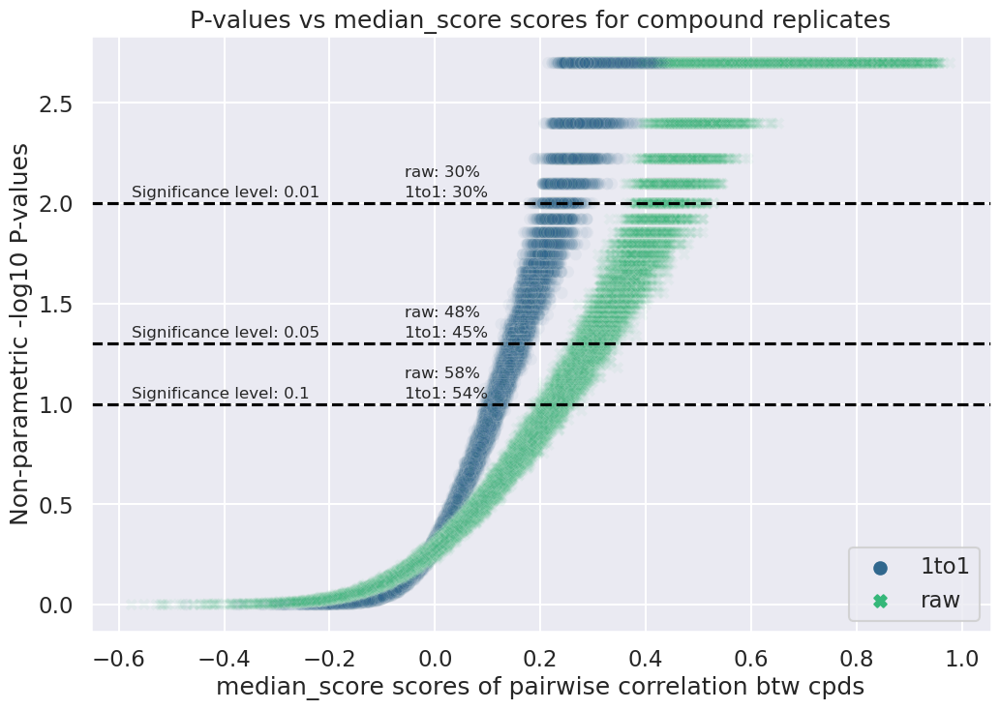

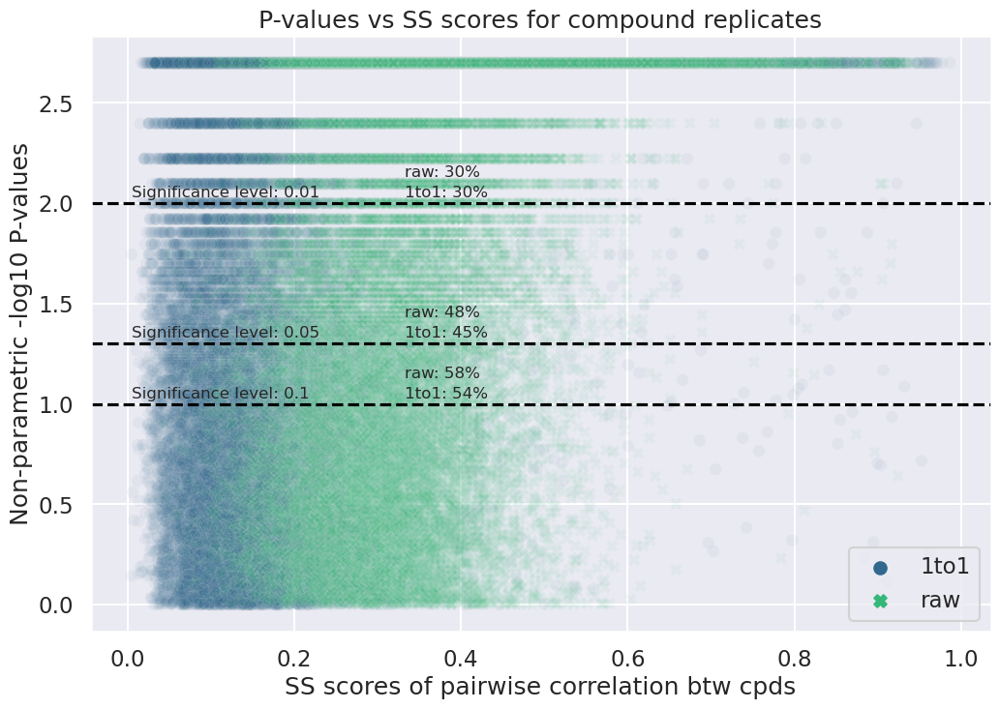

In [75]:
# percantage_replicating_df = percantage_replicating_df[percantage_replicating_df['method']!='raw1to1']
alpha = 0.05
plot_p_vs_median(melt_all,'cellpainting_figures', 'p_vs_median.png',x_col="median_score",y_col='pval_log', alpha=alpha)
plot_p_vs_median(melt_all,'cellpainting_figures', 'p_vs_fraction.png', x_col="SS",y_col='pval_log', alpha=alpha)


In [ ]:
# percantage_replicating_df = percantage_replicating_df[percantage_replicating_df['method']!='raw1to1']
alpha = 0.2
plot_p_vs_median(melt_percentile,'cellpainting_figures', 'p_vs_median.png',x_col="median_score",y_col='pval_log', alpha=alpha)
plot_p_vs_median(melt_percentile,'cellpainting_figures', 'p_vs_fraction.png', x_col="SS",y_col='pval_log', alpha=alpha)


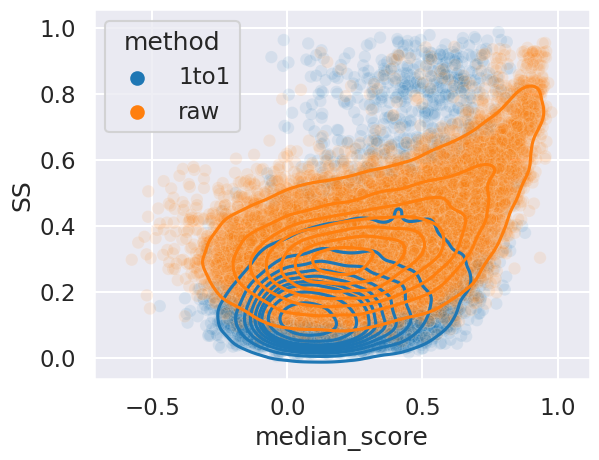

In [77]:
ax = sns.kdeplot(data=melt_all, x='median_score', y='SS',hue='method')
ax = sns.scatterplot(data=melt_all, x='median_score', y='SS',hue='method',alpha=0.1)
# ax.plot([-0.5,3.5],[-0.5,3.5], 'r--')

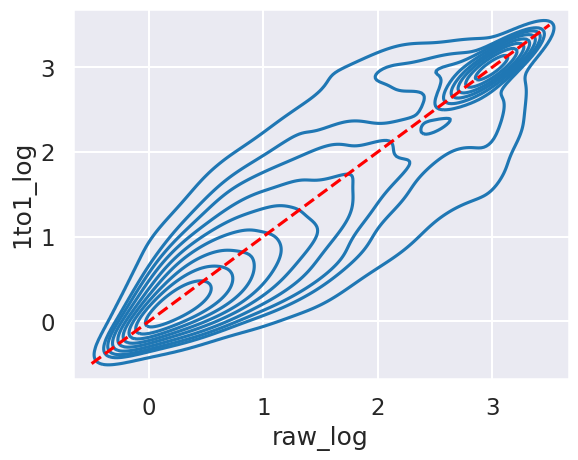

In [29]:
ax = sns.kdeplot(data=percantage_replicating_df_non_melt, x='raw_log', y='1to1_log')
ax.plot([-0.5,3.5],[-0.5,3.5], 'r--')

### Sample unreproducible hits

In [41]:
unreproduce_hits = pr_ss[(pr_ss['method'] == '1to1') & (pr_ss['SS']>0.5) & (pr_ss['pval']>0.1)]
int((len(unreproduce_hits)/len(percantage_replicating_df_non_melt) ) * len(percantage_replicating_df_non_melt) )


32

In [42]:
unreproduce_hits_idx = unreproduce_hits['index']
unreproduce_hits_idx

722      BRD-A39737108-003-05-5
2390     BRD-K02615925-003-06-3
2589     BRD-K03530975-001-05-8
3058     BRD-K05711643-001-06-2
3510     BRD-K07669546-001-05-0
3512     BRD-K07678613-001-01-8
3629     BRD-K08227755-001-05-2
3665     BRD-K08409398-001-06-7
3890     BRD-K09460252-001-01-5
4835     BRD-K13847800-001-05-5
5330     BRD-K16038004-003-06-6
5698     BRD-K17705806-003-01-0
7299     BRD-K24727119-001-01-1
7588     BRD-K25996664-001-01-0
9815     BRD-K35616093-001-01-3
10073    BRD-K36591038-001-04-9
11287    BRD-K41700431-001-01-8
12434    BRD-K46449123-001-01-0
13440    BRD-K50755896-001-01-8
13513    BRD-K51052187-001-01-7
17068    BRD-K66434795-001-05-5
17287    BRD-K67258146-001-01-2
17302    BRD-K67322403-001-01-4
18475    BRD-K72336314-001-06-4
19169    BRD-K75464194-001-04-1
19205    BRD-K75627148-001-01-6
20209    BRD-K79857601-001-09-8
20506    BRD-K81174269-001-04-8
22091    BRD-K88133561-001-06-7
22546    BRD-K90053518-001-07-5
22774    BRD-K91188267-001-05-5
23961   

In [36]:
zscores['1to1']['all'].head()
for idx in unreproduce_hits_idx:
    trt_samples = zscores['1to1']['all'].loc[:,:,idx,:]
    
    

In [37]:
# zscores['1to1']['all'].loc[:,:,'BRD-K17705806-003-01-0',:]
z = zscores['1to1']['trt'].loc[:,:,unreproduce_hits_idx.values[0],:]
z = z.reindex(sorted(z.columns), axis=1)
z

,,,,Cells_Granularity_1_AGP,Cells_Granularity_1_ER,Cells_Granularity_1_Mito,Cells_Granularity_1_RNA,Cells_Intensity_IntegratedIntensityEdge_AGP,Cells_Intensity_IntegratedIntensityEdge_DNA,Cells_Intensity_IntegratedIntensityEdge_ER,Cells_Intensity_IntegratedIntensityEdge_Mito,Cells_Intensity_IntegratedIntensityEdge_RNA,Cells_Intensity_IntegratedIntensity_AGP,...,Cells_Texture_SumAverage_RNA_3_0,Cells_Texture_SumEntropy_AGP_10_0,Cells_Texture_SumEntropy_ER_10_0,Cells_Texture_SumEntropy_Mito_10_0,Cells_Texture_SumEntropy_RNA_10_0,Cells_Texture_SumVariance_AGP_10_0,Cells_Texture_SumVariance_DNA_10_0,Cells_Texture_SumVariance_ER_10_0,Cells_Texture_SumVariance_Mito_10_0,Cells_Texture_SumVariance_RNA_10_0
Plate,Metadata_ASSAY_WELL_ROLE,Metadata_broad_sample,Image_Metadata_Well,,,,,,,,,,,,,,,,,,,,,
25689,treated,BRD-A39737108-003-05-5,o14,5.265306,5.395822,4.753591,8.018680,47.147781,417.764096,124.934366,167.843616,80.086474,0.095156,...,1.554779,1.008962,2.051516,11.244752,1.639889,0.967020,2.449620,3.325353,5.338270,4.236745
25690,treated,BRD-A39737108-003-05-5,o14,9.586304,7.897597,58.064710,22.434770,55.520105,986.701918,961.638245,356.421488,298.243987,274.176613,...,11.217960,101.347124,80.389327,312.270600,5.042924,5.539333,14.751514,7.482556,56.213754,2.152853
25692,treated,BRD-A39737108-003-05-5,o14,2.465317,2.784268,-1.452160,2.861098,29.933952,8.724798,13.033279,26.285034,5.619227,3.189345,...,2.793808,38.022076,1.121797,3.518460,4.988358,31.146320,1.277132,13.231196,19.336223,6.635805
25724,treated,BRD-A39737108-003-05-5,o14,2.633807,1.123980,1.937551,4.551791,1.035626,-0.220518,0.087625,0.722145,-0.224796,0.035647,...,3.272531,2.510727,2.485193,9.570866,5.464383,22.839839,4.276266,5.033848,13.017902,7.418154


In [38]:
melt_all[(melt_all['index']==unreproduce_hits_idx.values[0]) & (melt_all['method']=='1to1')]['SS'].values[0]


0.8520710059171598

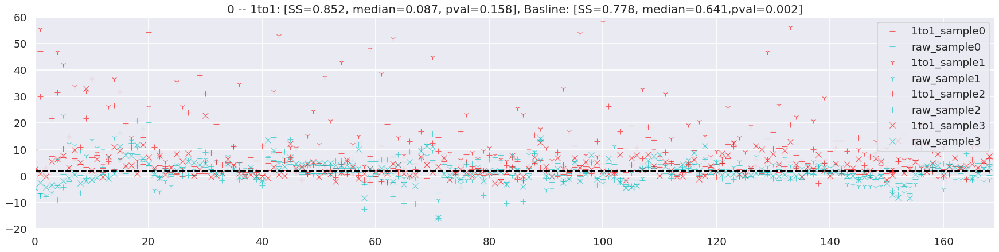

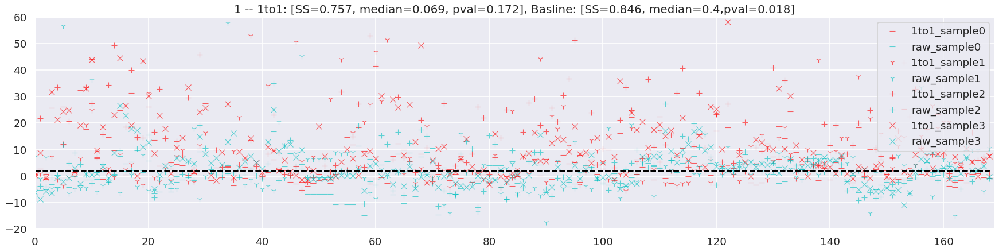

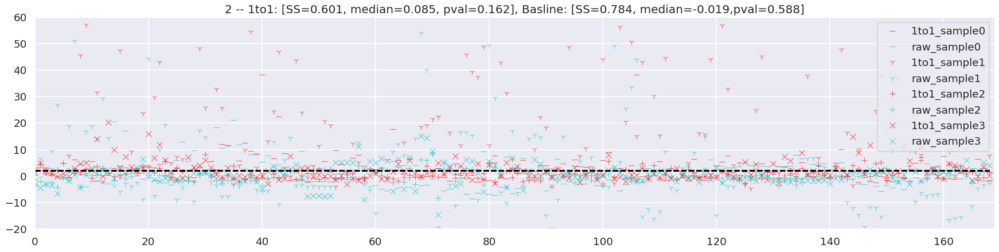

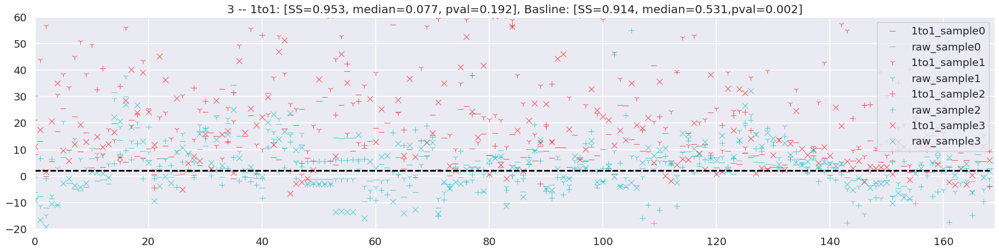

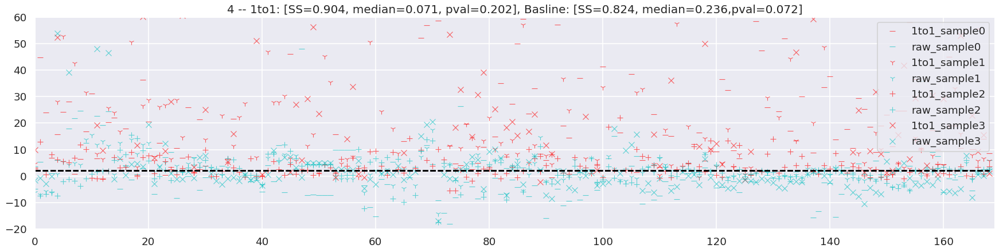

...

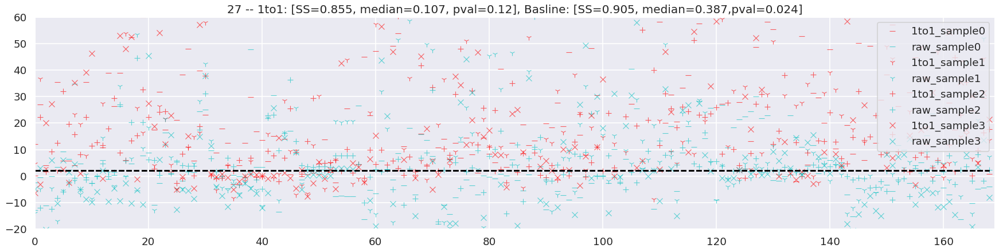

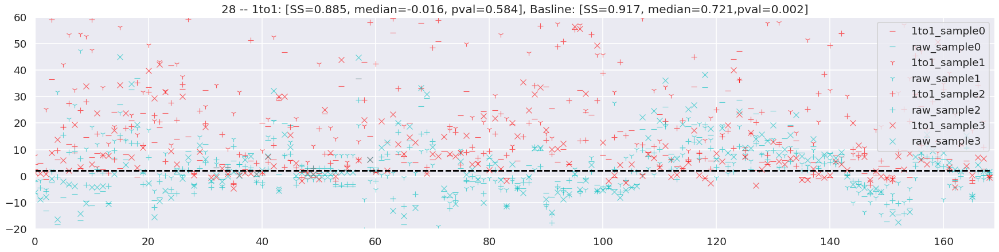

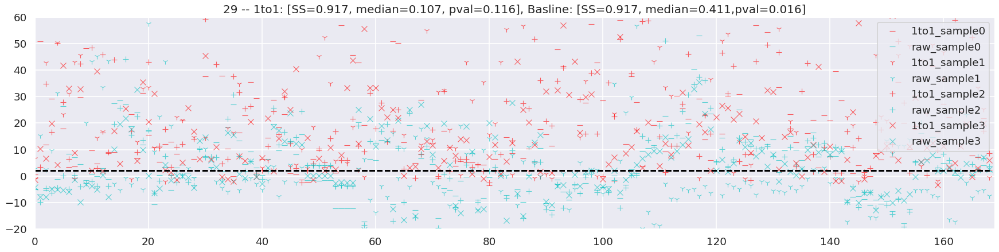

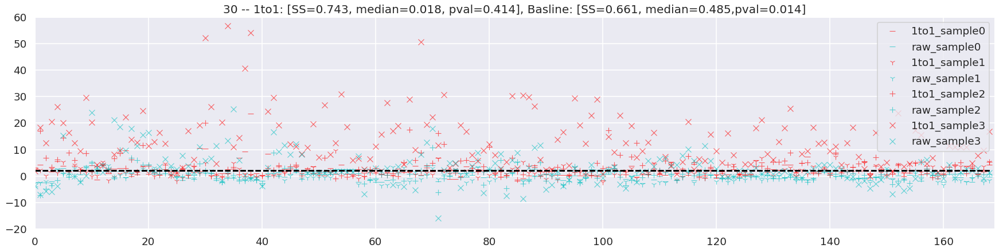

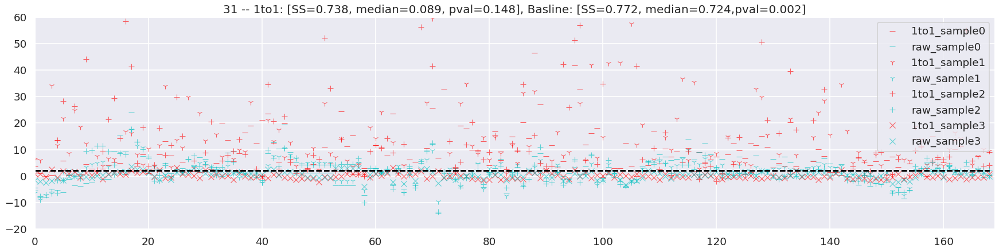

In [74]:
# zscores['raw']['trt'].loc[:,:,unreproduce_hits_idx.values[0],:].values.shape
colors = ['r','b','g','c']


markers = ["_", "1","+","x"]

for u in range(len(unreproduce_hits_idx)):
    plt.figure(figsize=(27, 6), dpi=80)
    for i in range(len(colors)):
        y1 = zscores['1to1']['trt'].loc[:,:,unreproduce_hits_idx.values[u],:].values[i,:]
        y1_ss = melt_all[(melt_all['index']==unreproduce_hits_idx.values[u]) & (melt_all['method']=='1to1')]['SS'].values[0]
        y1_median = melt_all[(melt_all['index']==unreproduce_hits_idx.values[u]) & (melt_all['method']=='1to1')]['median_score'].values[0]
        y1_pval = melt_all[(melt_all['index']==unreproduce_hits_idx.values[u]) & (melt_all['method']=='1to1')]['pval'].values[0]
        
        y2 = zscores['raw']['trt'].loc[:,:,unreproduce_hits_idx.values[u],:].values[i,:]
        y2_ss = melt_all[(melt_all['index']==unreproduce_hits_idx.values[u]) & (melt_all['method']=='raw')]['SS'].values[0]
        y2_median = melt_all[(melt_all['index']==unreproduce_hits_idx.values[u]) & (melt_all['method']=='raw')]['median_score'].values[0]
        y2_pval = melt_all[(melt_all['index']==unreproduce_hits_idx.values[u]) & (melt_all['method']=='raw')]['pval'].values[0]
        
        x = range(len(y1))
        
        plt.plot(x, y1, color = 'r', linestyle='none', marker = markers[i],label=f"1to1_sample{i}",alpha=0.6)
        plt.plot(x, y2, color = 'c', linestyle='none' ,marker = markers[i], label =f"raw_sample{i}", alpha=0.6)
        plt.plot(x,[2]*len(x), color='black', linestyle='--')
        plt.title(f'{u} -- 1to1: [SS={np.round(y1_ss,3)}, median={np.round(y1_median,3)}, pval={np.round(y1_pval,3)}], Basline: [SS={np.round(y2_ss,3)}, median={np.round(y2_median,3)},pval={np.round(y2_pval,3)}]')
        plt.legend(loc='upper right')
        plt.ylim([-20,60])
        plt.xlim([0,169])
    
    plt.show()
        

In [43]:
melt_all

,index,method,SS,median_score,pval,pval_log
0,BRD-A00037023-001-05-1,1to1,0.115385,0.275282,0.004,2.397940
1,BRD-A00051892-001-05-0,1to1,0.065089,0.202930,0.014,1.853872
2,BRD-A00214921-001-04-2,1to1,0.050296,0.139107,0.066,1.180456
3,BRD-A00250346-001-05-0,1to1,0.170118,0.146440,0.048,1.318759
4,BRD-A00430899-001-05-9,1to1,0.113905,0.277543,0.004,2.397940
...,...,...,...,...,...,...
49861,BRD-M97057852-001-01-4,raw,0.325444,0.306816,0.052,1.283997
49862,BRD-M97109212-001-01-8,raw,0.439349,0.247369,0.096,1.017729
49863,BRD-M97925630-001-01-1,raw,0.235207,0.364925,0.014,1.853872
49864,BRD-M98484762-001-01-8,raw,0.266272,0.211608,0.132,0.879426


In [41]:
len(unreproduce_hits_idx)

32

In [129]:
from sklearn.preprocessing import StandardScaler

In [130]:
scaler = StandardScaler()

In [132]:
scaler.fit_transform(zscores['1to1']['trt'].loc[:,:,unreproduce_hits_idx.values[u],:].values).shape

(4, 169)

In [128]:
zscores['1to1']['trt'].loc[:,:,unreproduce_hits_idx.values[u],:].values.shape

(4, 169)

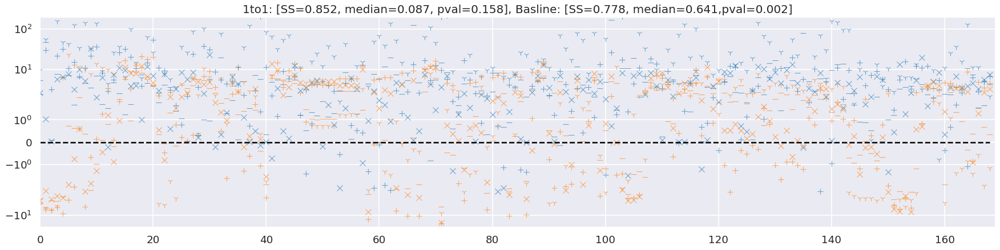

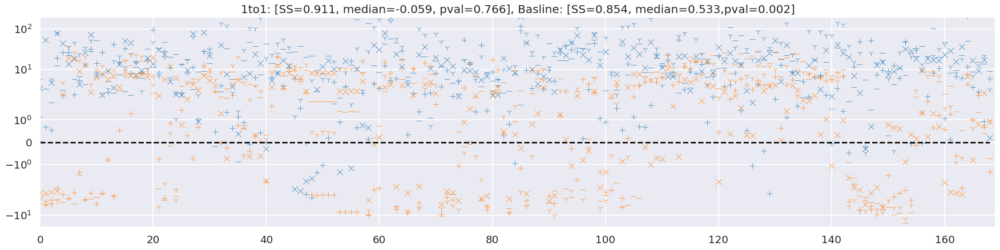

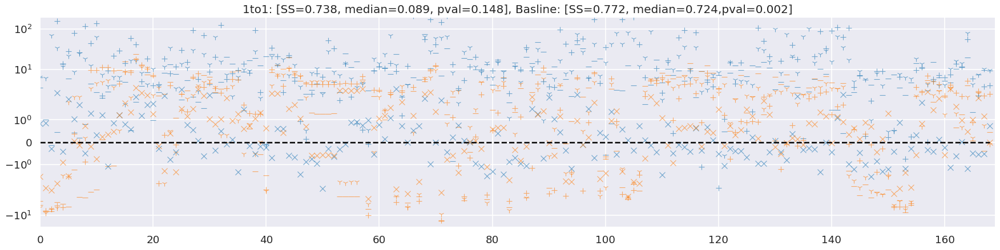

In [173]:
# zscores['raw']['trt'].loc[:,:,unreproduce_hits_idx.values[0],:].values.shape
colors = ['r','b','g','c']


markers = ["_", "1","+","x"]

for u in range(len(unreproduce_hits_idx)):
    if u not in [0, 6, 31]:
        continue
    plt.figure(figsize=(27, 6), dpi=80)
    ys_1to1 = zscores['1to1']['trt'].loc[:,:,unreproduce_hits_idx.values[u],:].values
    # scaler = StandardScaler()
    # ys_1to1 = scaler.fit_transform(ys_1to1)
    ys_raw = zscores['raw']['trt'].loc[:,:,unreproduce_hits_idx.values[u],:].values
    # scaler = StandardScaler()
    # ys_raw = scaler.fit_transform(ys_raw)
    
    for i in range(len(colors)):
        y1 = ys_1to1[i,:]
        y1_ss = melt_all[(melt_all['index']==unreproduce_hits_idx.values[u]) & (melt_all['method']=='1to1')]['SS'].values[0]
        y1_median = melt_all[(melt_all['index']==unreproduce_hits_idx.values[u]) & (melt_all['method']=='1to1')]['median_score'].values[0]
        y1_pval = melt_all[(melt_all['index']==unreproduce_hits_idx.values[u]) & (melt_all['method']=='1to1')]['pval'].values[0]
        
        y2 = ys_raw[i,:]
        y2_ss = melt_all[(melt_all['index']==unreproduce_hits_idx.values[u]) & (melt_all['method']=='raw')]['SS'].values[0]
        y2_median = melt_all[(melt_all['index']==unreproduce_hits_idx.values[u]) & (melt_all['method']=='raw')]['median_score'].values[0]
        y2_pval = melt_all[(melt_all['index']==unreproduce_hits_idx.values[u]) & (melt_all['method']=='raw')]['pval'].values[0]
        
        x = range(len(y1))
        
        plt.plot(x, y1, color = 'C0', linestyle='none', marker = markers[i], label=f"1to1_sample{i}",alpha=0.6)
        plt.plot(x, y2, color = 'C1', linestyle='none' ,marker = markers[i], label =f"raw_sample{i}", alpha=0.6)
        
        # plt.plot(x, y1, color = 'C0', linestyle=':', label=f"1to1_sample{i}") 
        # plt.plot(x, y2, color = 'C1', linestyle=':', label=f"raw_sample{i}")
        
    # plt.plot(x, zscores['1to1']['trt'].loc[:,:,unreproduce_hits_idx.values[u],:].median(), color = 'C0', linestyle='-', label=f"1to1_sample_median")
    # plt.plot(x, zscores['raw']['trt'].loc[:,:,unreproduce_hits_idx.values[u],:].median(), color = 'C1', linestyle='-', label=f"raw_sample_median")
    
    plt.plot(x,[0]*len(x), color='black', linestyle='--')
    plt.title(f'1to1: [SS={np.round(y1_ss,3)}, median={np.round(y1_median,3)}, pval={np.round(y1_pval,3)}], Basline: [SS={np.round(y2_ss,3)}, median={np.round(y2_median,3)},pval={np.round(y2_pval,3)}]')
    # plt.legend(loc='upper right')
    plt.ylim([-20,200])
    plt.xlim([0,169])
    plt.yscale('symlog')
    
    # plt.savefig(os.path.join(f'/sise/assafzar-group/g-and-n/tabular_models_results/plots/reproducibility', f'sample{u}') +'.eps', format='eps')
    # plt.savefig(os.path.join(f'/sise/assafzar-group/g-and-n/tabular_models_results/plots/reproducibility', f'sample{u}') +'.png', format='png')
    plt.show()
        

In [98]:
zscores['1to1']['trt'].loc[:,:,unreproduce_hits_idx.values[u],:].describe()

,Cells_Granularity_1_AGP,Cells_Intensity_IntegratedIntensityEdge_AGP,Cells_Intensity_IntegratedIntensity_AGP,Cells_Intensity_MADIntensity_AGP,Cells_Intensity_MassDisplacement_AGP,Cells_Intensity_MaxIntensityEdge_AGP,Cells_Intensity_MaxIntensity_AGP,Cells_Intensity_MinIntensity_AGP,Cells_Intensity_StdIntensity_AGP,Cells_Location_CenterMassIntensity_X_AGP,...,Cells_Texture_Gabor_RNA_3,Cells_Texture_Gabor_RNA_5,Cells_Texture_InfoMeas1_RNA_10_0,Cells_Texture_InfoMeas1_RNA_5_0,Cells_Texture_InfoMeas2_RNA_10_0,Cells_Texture_InfoMeas2_RNA_3_0,Cells_Texture_InverseDifferenceMoment_RNA_10_0,Cells_Texture_SumAverage_RNA_3_0,Cells_Texture_SumEntropy_RNA_10_0,Cells_Texture_SumVariance_RNA_10_0
count,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,...,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000
mean,4.268115,225.896072,252.391378,48.707357,9.595167,14.450988,22.241676,13.306714,33.836749,15.500794,...,4.406614,3.831299,5.228551,9.878584,9.203012,37.887673,2.731355,4.152679,5.688565,5.820744
std,2.659906,446.542895,460.428116,74.225440,6.726727,12.562090,37.906007,14.301649,55.799214,19.560764,...,3.153997,2.855219,4.782127,7.437827,6.268464,35.587206,2.839023,3.998796,5.016330,4.211271
min,0.827819,0.849467,-0.281803,0.445176,-0.402920,1.930359,0.433006,0.205151,-0.480014,1.278309,...,0.131213,-0.226199,-1.116653,-0.630521,0.010410,-1.188613,-0.489844,-0.546727,-0.508829,0.724274
25%,2.840186,0.973824,-0.167420,2.076392,8.636381,4.888794,0.879840,1.312433,0.483730,3.650742,...,3.020590,3.007195,3.173913,7.504821,8.391266,14.277206,0.890683,1.516973,2.683862,3.185849
50%,4.908973,3.517036,34.266347,18.380252,12.568208,13.833672,4.856497,13.303398,9.652879,8.356700,...,5.161119,4.614416,5.981739,11.911878,11.339755,37.160115,2.786800,4.838085,6.592665,6.555680
75%,6.336903,228.439284,286.825144,65.011216,13.526994,23.395865,26.218333,25.297678,43.005898,20.206753,...,6.547143,5.438520,8.036377,14.285641,12.151501,60.770583,4.627472,7.473791,9.597369,9.190576
max,6.426696,895.700751,941.314622,157.623748,13.647172,28.206248,78.820704,26.414908,116.521251,44.011467,...,7.173006,6.322565,10.067378,16.321103,14.122128,78.419077,5.841664,7.481271,10.077760,9.447344


In [53]:
zscores['1to1']['trt'].loc[:,:,unreproduce_hits_idx,:].describe().T.describe()

,count,mean,std,min,25%,50%,75%,max
count,169.0,169.000000,169.000000,169.000000,169.000000,169.000000,169.000000,169.000000
mean,128.0,51.500677,213.458887,-3.795587,0.910379,4.497624,19.606718,2001.986233
std,0.0,89.151989,419.568873,1.871582,0.707061,2.141143,13.256779,4135.444858
min,128.0,4.949821,7.550882,-10.202616,-0.642720,0.980634,3.368738,42.357125
25%,128.0,12.761192,32.708640,-4.670549,0.402736,2.828009,10.652549,262.119641
50%,128.0,23.630133,73.018063,-3.589422,0.909142,4.000277,16.336123,604.240202
75%,128.0,48.271474,198.336643,-2.398031,1.378649,5.928754,24.071381,1802.059627
max,128.0,721.635102,2968.502432,-0.827485,2.888783,11.839152,93.488914,33526.981617


In [54]:
zscores['raw']['trt'].loc[:,:,unreproduce_hits_idx,:].describe().T.describe()

,count,mean,std,min,25%,50%,75%,max
count,169.0,169.000000,169.000000,169.000000,169.000000,169.000000,169.000000,169.000000
mean,128.0,2.299978,9.434464,-14.325209,-1.821515,0.726610,4.190512,57.300990
std,0.0,4.228729,9.555134,9.809505,2.344764,2.013401,3.517629,97.351601
min,128.0,-10.335255,2.499386,-61.755215,-14.246223,-7.631178,-1.805765,2.673879
25%,128.0,-0.326319,5.020412,-18.099442,-2.271581,-0.343959,1.832694,14.801261
50%,128.0,1.887756,6.529896,-11.749793,-1.301486,0.714857,3.403475,28.246551
75%,128.0,4.460866,9.702443,-7.547980,-0.429432,1.388925,5.678851,51.076320
max,128.0,23.980620,73.609238,-2.824965,2.439862,7.659340,17.254821,662.688219


In [152]:
df1 = pd.DataFrame(ys_1to1)
df1['method'] = '1to1'
df2 = pd.DataFrame(ys_raw)
df2['method'] = 'raw'
res = pd.concat([df1, df2])
res

,0,1,2,3,4,5,6,7,8,9,...,160,161,162,163,164,165,166,167,168,method
0,3.510975,1.015277,-0.129292,0.445176,13.647172,5.874940,0.433006,0.205151,0.804978,4.441553,...,5.143839,4.604101,10.216601,11.184884,19.432479,1.350858,7.481271,9.437238,9.104986,1to1
1,6.426696,6.018795,68.661985,34.140372,11.649481,21.792404,8.684210,24.925268,18.500781,12.271848,...,4.084993,10.067378,16.321103,14.122128,78.419077,4.222742,7.471298,10.077760,9.447344,1to1
2,6.306971,895.700751,941.314622,157.623748,13.486935,28.206248,78.820704,26.414908,116.521251,44.011467,...,6.322565,7.359377,13.607154,11.494626,54.887751,5.841664,2.204873,3.748092,4.006374,1to1
3,0.827819,0.849467,-0.281803,2.620131,-0.402920,1.930359,1.028785,1.681527,-0.480014,1.278309,...,-0.226199,-1.116653,-0.630521,0.010410,-1.188613,-0.489844,-0.546727,-0.508829,0.724274,1to1
0,-5.519448,-8.047731,-8.138986,-4.744706,-5.240761,-6.132208,-1.216182,-3.597181,-3.678954,-2.669055,...,2.048550,3.638954,0.658614,1.228663,3.913641,0.068753,2.666156,-0.392480,0.452517,raw
1,-6.442990,-8.967569,-7.143431,-6.570732,-1.483784,1.803540,2.098053,2.090118,0.189213,3.368785,...,1.230624,3.311807,1.300914,0.670687,2.073405,0.191394,2.554964,0.744760,-0.092785,raw
2,-4.469945,-7.713341,-7.074992,-5.829794,-6.414658,-1.540903,0.363001,0.015786,-0.873958,9.403932,...,2.189130,4.154256,2.622574,2.104727,5.100356,0.878595,2.824657,2.214782,2.415362,raw
3,-1.537478,-2.104534,-2.367547,-1.840961,-0.894367,-1.508950,0.040529,-0.144465,0.741771,-0.195303,...,-0.563106,3.227720,1.583931,0.994580,0.487898,1.006130,1.966853,1.150588,-0.010743,raw


In [170]:
res.groupby('method').std()

,0,1,2,3,4,5,6,7,8,9,...,159,160,161,162,163,164,165,166,167,168
method,,,,,,,,,,,,,,,,,,,,,
1to1,2.659906,446.542895,460.428116,74.225440,6.726727,12.562090,37.906007,14.301649,55.799214,19.560764,...,3.153997,2.855219,4.782127,7.437827,6.268464,35.587206,2.839023,3.998796,5.016330,4.211271
raw,2.128513,3.114650,2.588540,2.077138,2.731279,3.260746,1.366416,2.356587,1.966803,5.240889,...,0.918291,1.265587,0.420013,0.818106,0.614236,2.030630,0.474505,0.374271,1.077434,1.174317


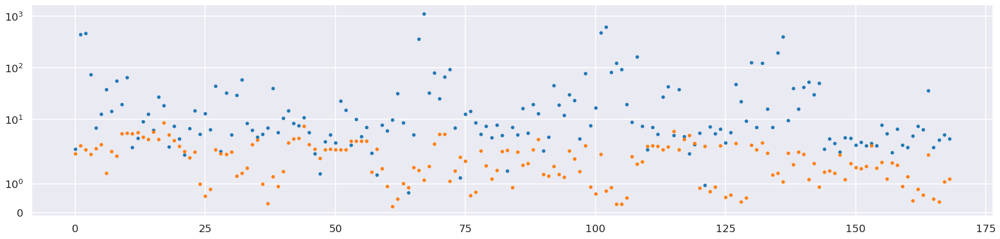

In [172]:
plt.figure(figsize=(27, 6), dpi=80)
plt.plot(x, res.groupby('method').std().loc['1to1'], '.')
plt.plot(x, res.groupby('method').std().loc['raw'], '.')
plt.yscale('symlog')

In [164]:
res.iloc[:,50:]

,50,51,52,53,54,55,56,57,58,59,...,160,161,162,163,164,165,166,167,168,method
0,2.659784,10.843084,4.775666,2.686052,24.502977,11.122307,15.332786,4.631995,2.966803,9.144386,...,5.143839,4.604101,10.216601,11.184884,19.432479,1.350858,7.481271,9.437238,9.104986,1to1
1,2.401004,27.509120,8.539293,7.132529,14.258404,5.790154,3.604993,4.205119,0.560228,18.282528,...,4.084993,10.067378,16.321103,14.122128,78.419077,4.222742,7.471298,10.077760,9.447344,1to1
2,6.362448,52.145157,33.016780,1.874839,13.806672,2.078026,0.828231,0.558559,-0.076449,9.282189,...,6.322565,7.359377,13.607154,11.494626,54.887751,5.841664,2.204873,3.748092,4.006374,1to1
3,-2.186954,-0.277714,-0.650496,-0.309445,-0.089925,0.882300,0.906298,0.751937,0.994518,-0.538227,...,-0.226199,-1.116653,-0.630521,0.010410,-1.188613,-0.489844,-0.546727,-0.508829,0.724274,1to1
0,1.266672,1.274515,1.281018,-3.455136,-3.464620,-3.428929,-3.448504,5.412445,-7.102064,2.160524,...,2.048550,3.638954,0.658614,1.228663,3.913641,0.068753,2.666156,-0.392480,0.452517,raw
1,4.975355,4.971342,4.982428,-1.764167,-1.802268,-1.765168,-1.768252,4.822882,-5.256456,-0.444903,...,1.230624,3.311807,1.300914,0.670687,2.073405,0.191394,2.554964,0.744760,-0.092785,raw
2,4.225227,4.228350,4.233093,4.368347,4.488250,4.392042,4.379398,6.656066,-9.982900,3.017578,...,2.189130,4.154256,2.622574,2.104727,5.100356,0.878595,2.824657,2.214782,2.415362,raw
3,-0.574389,-0.574539,-0.582436,2.971899,3.005409,2.960732,2.956662,3.232536,-3.935681,0.650558,...,-0.563106,3.227720,1.583931,0.994580,0.487898,1.006130,1.966853,1.150588,-0.010743,raw


In [154]:
res.melt(id_vars='method')

,method,variable,value
0,1to1,0,3.510975
1,1to1,0,6.426696
2,1to1,0,6.306971
3,1to1,0,0.827819
4,raw,0,-5.519448
...,...,...,...
1347,1to1,168,0.724274
1348,raw,168,0.452517
1349,raw,168,-0.092785
1350,raw,168,2.415362


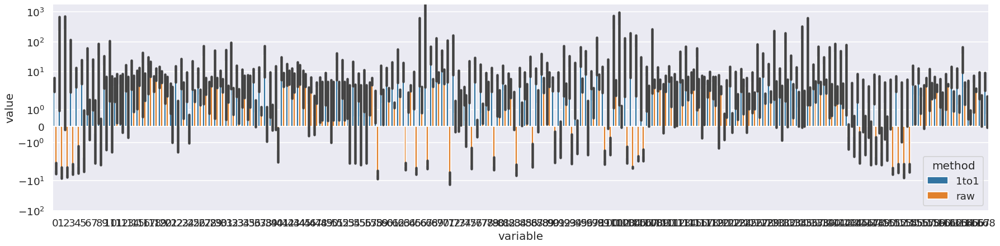

In [169]:
plt.figure(figsize=(27, 6), dpi=80)
sns.barplot(data=res.melt(id_vars='method'), hue='method', x='variable', y='value')
plt.yscale('symlog')
plt.show()

/tmp/ipykernel_12305/1446176364.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(27, 6), dpi=80)


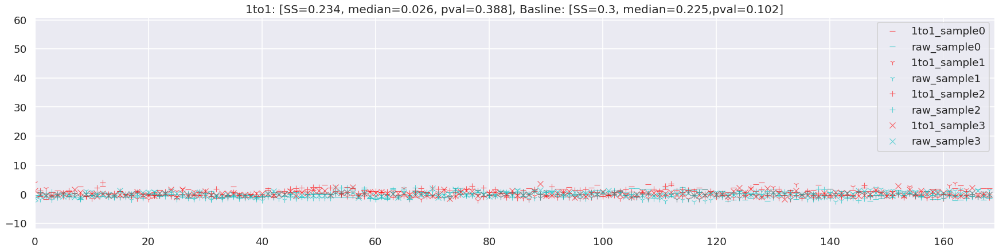

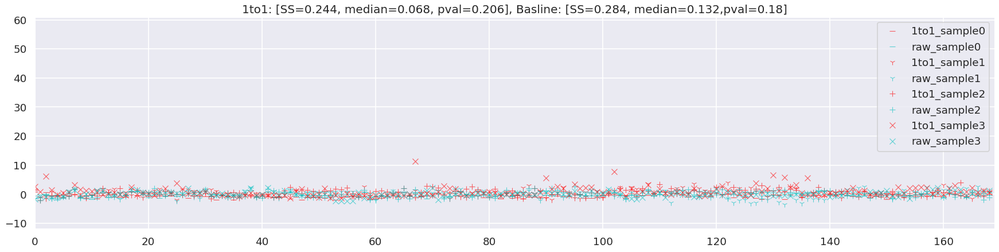

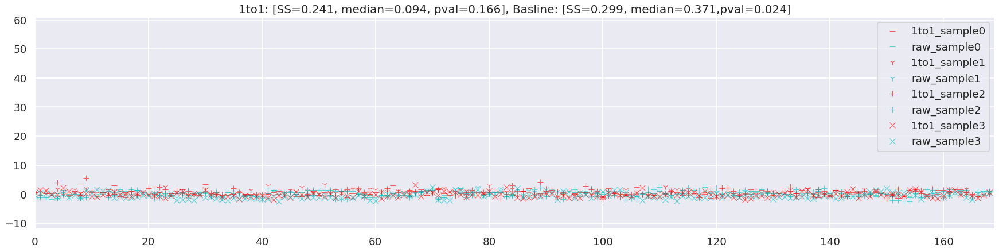

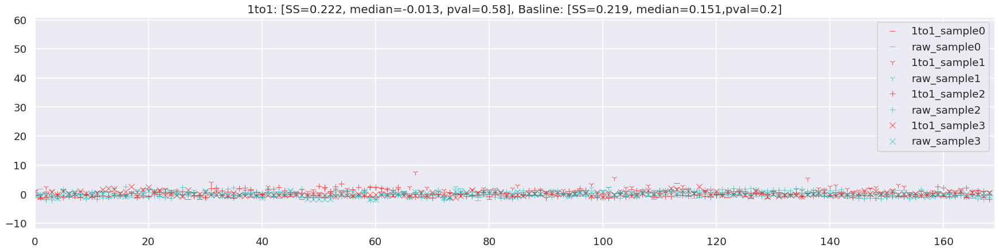

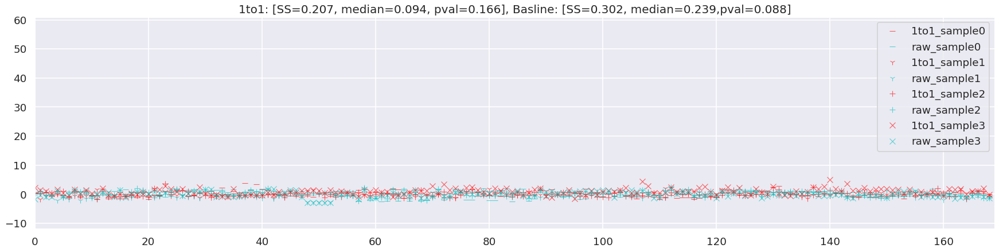

...

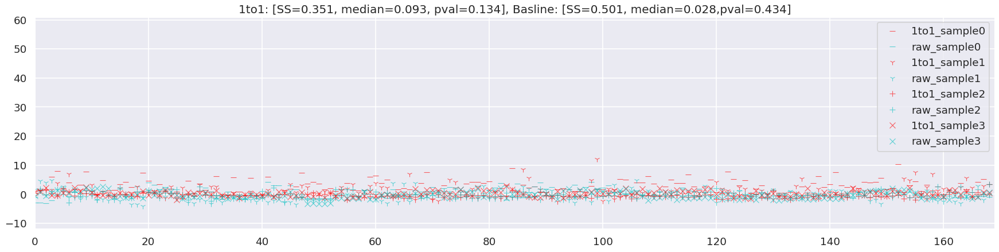

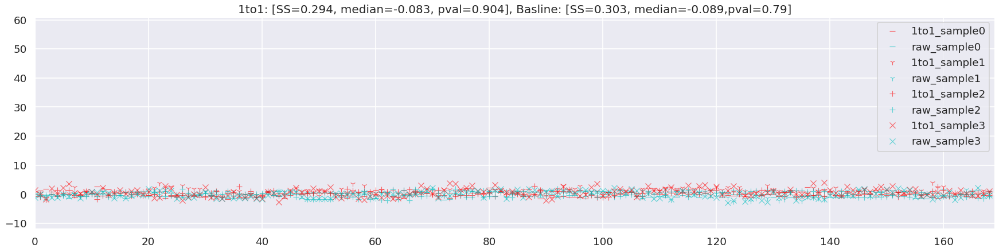

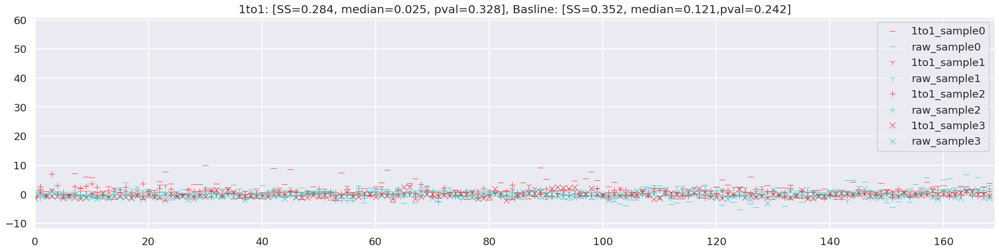

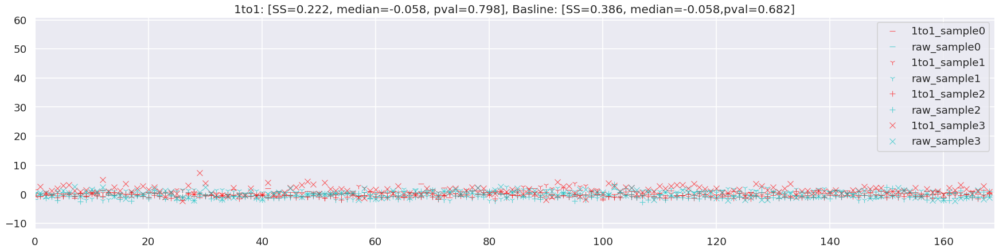

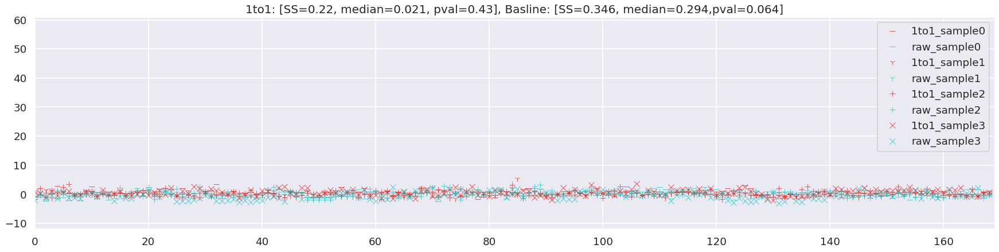

In [ ]:
# zscores['raw']['trt'].loc[:,:,unreproduce_hits_idx.values[0],:].values.shape
# colors = ['r','b','g','c']


markers = ["_", "1","+","x"]

for u in range(len(unreproduce_hits_idx)):
    plt.figure(figsize=(27, 6), dpi=80)
    for i in range(len(colors)):
        y1 = zscores['1to1']['trt'].loc[:,:,unreproduce_hits_idx.values[u],:].values[i,:]
        y1[y1>60]=60
        y1[(60>y1) & (y1>50)]=50
        y1[(50>y1) & (y1>40)]=40
        y1[(40>y1) & (y1>30)]=30
        y1[(30>y1) & (y1>20)]=20
        y1_ss = melt_all[(melt_all['index']==unreproduce_hits_idx.values[u]) & (melt_all['method']=='1to1')]['SS'].values[0]
        y1_median = melt_all[(melt_all['index']==unreproduce_hits_idx.values[u]) & (melt_all['method']=='1to1')]['median_score'].values[0]
        y1_pval = melt_all[(melt_all['index']==unreproduce_hits_idx.values[u]) & (melt_all['method']=='1to1')]['pval'].values[0]
        
        y2 = zscores['raw']['trt'].loc[:,:,unreproduce_hits_idx.values[u],:].values[i,:]
        y2_ss = melt_all[(melt_all['index']==unreproduce_hits_idx.values[u]) & (melt_all['method']=='raw')]['SS'].values[0]
        y2_median = melt_all[(melt_all['index']==unreproduce_hits_idx.values[u]) & (melt_all['method']=='raw')]['median_score'].values[0]
        y2_pval = melt_all[(melt_all['index']==unreproduce_hits_idx.values[u]) & (melt_all['method']=='raw')]['pval'].values[0]
        
        x = range(len(y1))
        plt.plot(x, y1, color = 'r', linestyle='none', marker = markers[i],label=f"1to1_sample{i}",alpha=0.6)
        plt.plot(x, y2, color = 'c', linestyle='none' ,marker = markers[i], label =f"raw_sample{i}", alpha=0.6)
        plt.title(f'1to1: [SS={np.round(y1_ss,3)}, median={np.round(y1_median,3)}, pval={np.round(y1_pval,3)}], Basline: [SS={np.round(y2_ss,3)}, median={np.round(y2_median,3)},pval={np.round(y2_pval,3)}]')
        plt.legend(loc='upper right')
        plt.ylim([-12,61])
        plt.xlim([0,169])
        

In [46]:
to1 = list(percantage_replicating_df_non_melt.filter(like='_1to1', axis=1).columns)
raw = list(percantage_replicating_df_non_melt.filter(like='_raw', axis=1).columns)

In [47]:
percantage_replicating_df_non_melt[['Metadata_broad_sample']+to1].melt(id_vars=['Metadata_broad_sample'], value_vars=to1)

,Metadata_broad_sample,variable,value
0,BRD-A00037023-001-05-1,ALL_SS_2_1to1,0.115385
1,BRD-A00051892-001-05-0,ALL_SS_2_1to1,0.065089
2,BRD-A01039955-001-05-8,ALL_SS_2_1to1,0.028107
3,BRD-A01047964-001-06-8,ALL_SS_2_1to1,0.464497
4,BRD-A01482803-001-05-4,ALL_SS_2_1to1,0.233728
...,...,...,...
63995,BRD-K99982687-001-01-4,ALL_SS_20_1to1,0.223373
63996,BRD-K99999497-001-01-8,ALL_SS_20_1to1,0.002959
63997,BRD-M07987005-001-06-6,ALL_SS_20_1to1,0.000000
63998,BRD-M57109082-001-05-4,ALL_SS_20_1to1,0.000000


In [150]:
def plot_score_distribution(df, title, path, file_name, x='p_val'):
    
    if not os.path.exists(path):
        os.mkdir(path)
        
    dis_plt = sns.displot(df, x=x, hue="method", kind="hist", 
                          multiple="stack", palette = 'viridis', height=6.5, aspect=1.7)
    dis_plt.fig.suptitle(title)
    dis_plt.fig.subplots_adjust(top=.92)
    plt.savefig(os.path.join(path, file_name))
    plt.show()
    

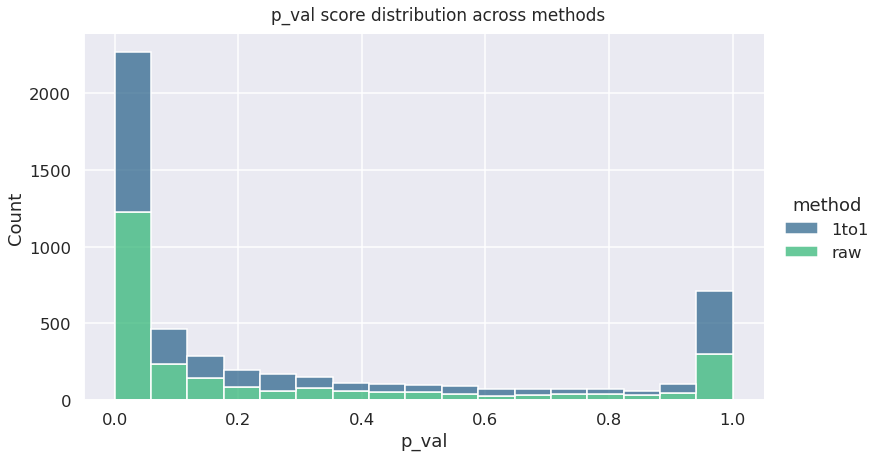

In [151]:
x_col = 'p_val'
plot_score_distribution(
    percantage_replicating_df,
    f"{x_col} score distribution across methods",
    'cellpainting_figures',
    'p_value_distribution_all.png',
    x='p_val'
)

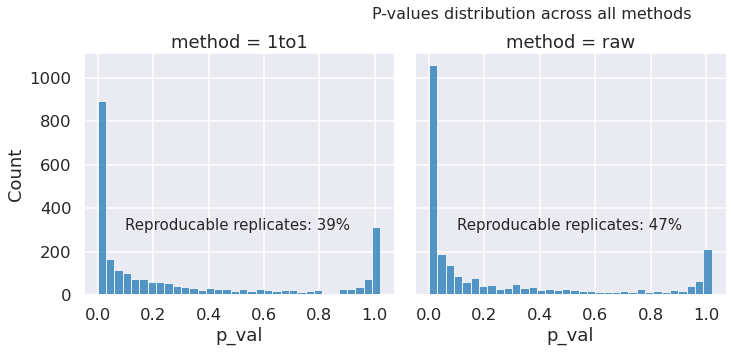

In [156]:
def plot_p_value_dist(df, path, file_name,thresh=0.05):
    """Plot p-values distribution"""
    if not os.path.exists(path):
        os.mkdir(path)  
    
    repr_score = {}
    methods = percantage_replicating_df.method.unique()
    for method in methods:
        df_method = percantage_replicating_df[percantage_replicating_df['method']==method]
        repr_score[method] = len(df_method[df_method['p_val']<=thresh])/ len(df_method)
    # repr_score
    dis_plt = sns.displot(df, x="p_val", col="method", col_wrap=3, binwidth=0.03)
    dis_plt.fig.suptitle("P-values distribution across all methods", size = 16)
    dis_plt.fig.subplots_adjust(top=.85)
    for ax, method in zip(dis_plt.axes.flat, methods):
        ax.text(0.1, 300,'Reproducable replicates: '+str(int(np.round(repr_score[method],2)*100))+'%', fontsize=15) #add text
    plt.savefig(os.path.join(path, file_name))
    plt.show()
    
plot_p_value_dist(percantage_replicating_df, 'cellpainting_figures', 'p_value_distribution_per_method.png',thresh=0.05)
repr_score = {}


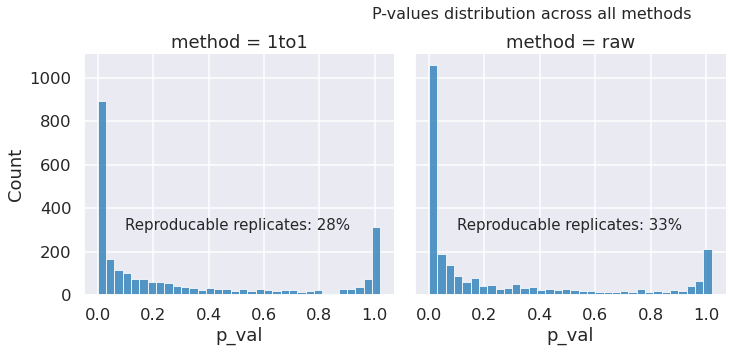

In [157]:
plot_p_value_dist(percantage_replicating_df, 'cellpainting_figures', 'p_value_distribution_per_method.png',thresh=0.01)
repr_score = {}

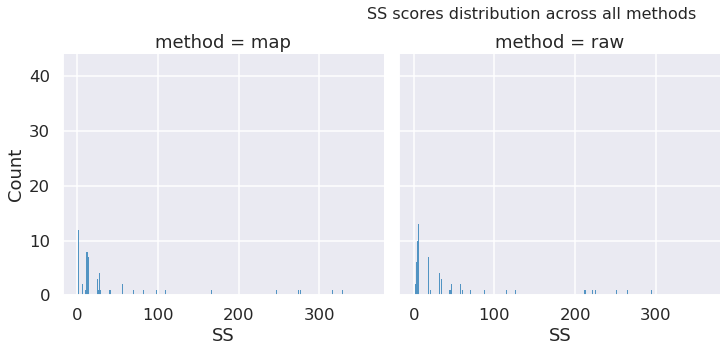

In [133]:
def plot_p_value_dist(df, path, file_name,x_col="fraction_score"):
    """Plot p-values distribution"""
    if not os.path.exists(path):
        os.mkdir(path)  
    dis_plt = sns.displot(df, x=x_col, col="method", col_wrap=3, binwidth=0.03)
    dis_plt.fig.suptitle(f"{x_col} scores distribution across all methods", size = 16)
    dis_plt.fig.subplots_adjust(top=.85)
    plt.savefig(os.path.join(path, file_name))
    plt.show()
                      
x_col="SS"
plot_p_value_dist(percantage_replicating_df, 'cellpainting_figures', f'{x_col}_score_distribution_per_method.png',x_col=x_col)

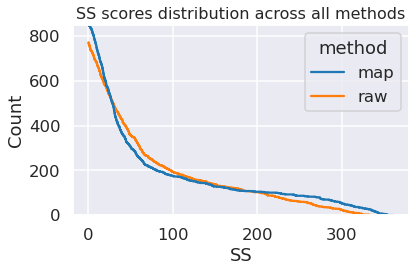

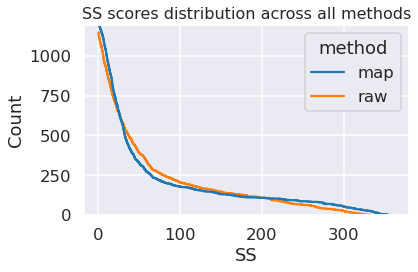

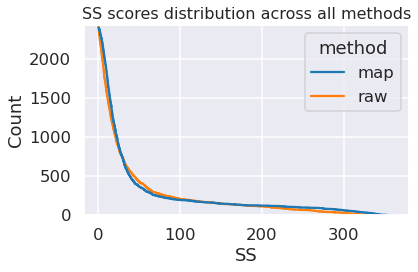

In [139]:
x='SS'

p_val_threshold = 0.01
plot_p_value_dist(percantage_replicating_df[percantage_replicating_df['p_val']<p_val_threshold], 
                  'cellpainting_figures', 
                  f'{x_col}_score ecdf for p_val smaller than {p_val_threshold}.png',
                 x_col=x
                  ,kind="ecdf")


p_val_threshold = 0.05
plot_p_value_dist(percantage_replicating_df[percantage_replicating_df['p_val']<p_val_threshold], 
                  'cellpainting_figures', 
                  f'{x_col}_score ecdf for p_val smaller than {p_val_threshold}.png',
                 x_col=x
                  ,kind="ecdf")

p_val_threshold = 1
plot_p_value_dist(percantage_replicating_df[percantage_replicating_df['p_val']<p_val_threshold], 
                  'cellpainting_figures', 
                  f'{x_col}_score ecdf for p_val smaller than {p_val_threshold}.png',
                 x_col=x
                  ,kind="ecdf")

In [205]:
# TODO
# 1. calc p-value for each cpd
# 2. plot graph
# 3. run for all plates
# 4. run on 1to1 and raw
# 4. add saving mechanisms
# 5. run for each scenario